## Download the video

We're going to use [yt-dlp](https://github.com/yt-dlp/yt-dlp) to download a video. It's not very fun to use so I recommend taking any troubles/questions to ChatGPT. It's a pretty popular piece of software so ChatGPT usually has good answers.

First we'll install it...

In [1]:
%pip install --quiet --upgrade "yt-dlp[default]"

69.96s - pydevd: Sending message related to process being replaced timed-out after 5 seconds



[notice] A new release of pip is available: 23.0.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


...then we'll use it to download [this video](https://www.youtube.com/shorts/rDXubdQdJYs). If you want a different video, you just change the URL inside of the quotes. It also works for TikTok, Vimeo, Instagram reels... almost anywhere with video! Just be sure to **re-run the line above to update the current version.**

In [ ]:
!yt-dlp "https://www.youtube.com/watch?v=1EMDl2t-YxE"

You can also provide extra parameters to `yt-dlp` to do things like download a specific size video, rename it, etc.

In [2]:
!yt-dlp -f 'bestvideo[height<=720]+bestaudio' -o "%(id)s.%(ext)s" "https://www.youtube.com/watch?v=1EMDl2t-YxE"

[youtube] Extracting URL: https://www.youtube.com/watch?v=1EMDl2t-YxE
[youtube] 1EMDl2t-YxE: Downloading webpage
[youtube] 1EMDl2t-YxE: Downloading tv client config
[youtube] 1EMDl2t-YxE: Downloading player b191cf34
[youtube] 1EMDl2t-YxE: Downloading tv player API JSON
[youtube] 1EMDl2t-YxE: Downloading ios player API JSON
[youtube] 1EMDl2t-YxE: Downloading m3u8 information
[info] 1EMDl2t-YxE: Downloading 1 format(s): 398+251
[download] Destination: 1EMDl2t-YxE.f398.mp4
[download] 100% of   14.17MiB in 00:00:01 at 9.14MiB/s0;33m00:000m
[download] Destination: 1EMDl2t-YxE.f251.webm
[download] 100% of    2.30MiB in 00:00:00 at 6.59MiB/s0;33m00:000m
[Merger] Merging formats into "1EMDl2t-YxE.webm"
Deleting original file 1EMDl2t-YxE.f251.webm (pass -k to keep)
Deleting original file 1EMDl2t-YxE.f398.mp4 (pass -k to keep)


The documentation is awful so I recommend just [asking an LLM about it](https://chatgpt.com/share/67c7359d-8a50-800d-8071-2486b25523ad).

## Preview the video

We can check out the video in our notebook!

In [3]:
from IPython.display import Video

Video("1EMDl2t-YxE.webm", width=800, embed=True)

## Splitting scenes

When you're interested in a video, you're often only interested in *part of* the video. Probably a specific scene! We're going to use [PySceneDetect](https://www.scenedetect.com/) to split our scenes.

We'll first download and install it...

In [ ]:
%pip install --upgrade --quiet scenedetect

...then use it to split the video into separate scenes (and few other things, too!).

When running the code below, pay attention to the **Merging formats into...** line from yt-dlp above. That's how you know know what filename to use! Sometimes the video is an mp4, but sometimes it's a webm or other format.

When we run the command below, it will...

- `detect-adaptive` or `detect-content` are the two approaches to splitting scenes
- `save-images` will save five images for each scene. They'll be in the `output` folder and be 300 pixels wide.
- `export-html` will save an HTML file that we can use to see an overview of each scene
- `list-scenes` will save a CSV file that lists each scene, along with details

If you wanted to see separate video files for each scene you could also add `split-video` at the end.

In [ ]:
!scenedetect -i "Protests erupt over Trump's immigration crackdown [1EMDl2t-YxE].webm" \
    detect-adaptive \
    save-images --output output --width 300 --num-images 5 \
    export-html --image-width 300 \
    list-scenes --skip-cuts

The best part is instead of just doing a bunch of blah blah blah coding stuff, **pySceneDetect creates an HTML file**. A file with all the information, that you can just open!

Let's open it!

In [11]:
!open "output/Protests erupt over Trump's immigration crackdown [1EMDl2t-YxE]-Scenes.html"

681.49s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Amazing.

It also includes a fun little CSV file that includes details about each scene.

In [13]:
import pandas as pd

df = pd.read_csv("Protests erupt over Trump's immigration crackdown [1EMDl2t-YxE]-Scenes.csv")
df.head()

,Scene Number,Start Frame,Start Timecode,Start Time (seconds),End Frame,End Timecode,End Time (seconds),Length (frames),Length (timecode),Length (seconds)
0,1,1,00:00:00.000,0.000,1196,00:00:39.904,39.904,1196,00:00:39.904,39.904
1,2,1197,00:00:39.904,39.904,1306,00:00:43.574,43.574,110,00:00:03.670,3.670
2,3,1307,00:00:43.574,43.574,1360,00:00:45.376,45.376,54,00:00:01.802,1.802
3,4,1361,00:00:45.376,45.376,1443,00:00:48.145,48.145,83,00:00:02.769,2.769
4,5,1444,00:00:48.145,48.145,1524,00:00:50.847,50.847,81,00:00:02.703,2.703


# Analyzing Trump vs Biden

### Download the video

In [ ]:
!yt-dlp -f 'bestvideo[height<=720]+bestaudio' -o "%(id)s.%(ext)s" "https://www.youtube.com/watch?v=rDXubdQdJYs"

### Split into scenes

Note that we're saving the content into the `debate` folder instead of the `output` folder this time.

In [19]:
!scenedetect -i "rDXubdQdJYs.webm" \
    detect-content \
    save-images --output debate --width 300 --num-images 3 \
    export-html --image-width 300 \
    list-scenes --skip-cuts

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
1154.10s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


[PySceneDetect] PySceneDetect 0.6.4
[PySceneDetect] Image output format set: JPEG [Quality: 95]
[PySceneDetect] Image output directory set:
  /Users/soma/Library/CloudStorage/Dropbox/Soma/Curriculum/2025-nicar/ai-images-video/debate
[PySceneDetect] HTML file name format:
 $VIDEO_NAME-Scenes.html
[PySceneDetect] Scene list filename format:
  $VIDEO_NAME-Scenes.csv
[PySceneDetect] Detecting scenes...                                             
  Detected: 15 | Progress: 100%|██████▉| 1770/1771 [00:02<00:00, 770.29frames/s]
[PySceneDetect] Processed 1770 frames in 2.3 seconds (average 765.80 FPS).
[PySceneDetect] Detected 16 scenes, average shot length 3.7 seconds.
[PySceneDetect] Writing scene list to CSV file:
  rDXubdQdJYs-Scenes.csv
[PySceneDetect] Scene List:
-----------------------------------------------------------------------
 | Scene # | Start Frame |  Start Time  |  End Frame  |   End Time   |
-----------------------------------------------------------------------
 |      1  |

### Manually count everything?

We could open up the output file to manually count what we're seeing, and sum up Biden and Trump seconds...

In [15]:
!open debate/rDXubdQdJYs-Scenes.html

934.46s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


...but what if we could do it **computationally?**

## Looking at one image

We'll start by inspecting **a single image**. You will need to change the filename if you're using a different video than me.

In [ ]:
%pip install -q "transformers[torch]" pillow

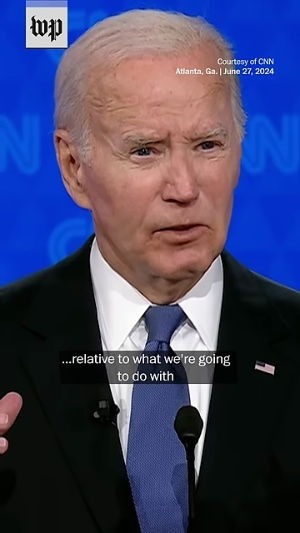

In [16]:
from IPython.display import Image

filename = "debate/rDXubdQdJYs-Scene-002-03.jpg"
Image(filename=filename) 

We want to know who's in the image, but don't want to send it off to an AI tool in the cloud – we're cheap! We're private! We're independent!

Instead, we're lucky that [there are entire tools that can categorize images for us](https://huggingface.co/openai/clip-vit-large-patch14) can do the detecting for us. You can test it out on the right-hand side of that page under **Inference API**.

This model is a "zero-shot classifier," which means we don't need to teach it what we're looking for, it already knows what (many) things in the world are.

> There are lot of different ways of analyzing images, including:
>
> - **Classification:** Put this image into a category
> - **Object detection:** Find specific objects in the image
> - **Semantic segmentation:** See what pixels belong to what (cars, people, the sky, etc)
>
> You can see a few examples at [normalai.org](https://normalai.org/), but it also might be useful to look at the [Hugging Face tasks page](https://huggingface.co/tasks). You can also email me, I'm happy to chat! You can find me at [js4571@columbia.edu](mailto:js4571@columbia.edu)

It's good to test our model first, because it might actually *not* understand what you want it to identify. While most models are good at things like cats and dogs and boats, our specific use case might be outside of its knowledge.

In [20]:
from transformers import pipeline
from PIL import Image

# Open the image
filename = "debate/rDXubdQdJYs-Scene-002-03.jpg"
image = Image.open(filename)

# Build a detector
detector = pipeline("zero-shot-image-classification", model="openai/clip-vit-large-patch14") 

# Use the detector
results = detector(image, candidate_labels=["donald trump", "joe biden"])
results

Device set to use mps:0


[{'score': 0.9991683959960938, 'label': 'joe biden'},
 {'score': 0.0008316343883052468, 'label': 'donald trump'}]

According to the model, it's almost 100% certain that the image is of Joe Biden.

## Looking at all of the images

Right now we're creating three images for each scene, `Scene-XXX-01.jpg` through `Scene-XXX-03.jpg`. I'm going to take the middle image – `Scene-XXX-02.jpg` and say it's representative of the rest of the scene.

Another approach might be to look at all of the images and pick the most popular label.......but this is easier!

In [22]:
import glob

filenames = glob.glob("debate/*-Scene-*-02.jpg")
filenames.sort()
filenames

['debate/rDXubdQdJYs-Scene-001-02.jpg',
 'debate/rDXubdQdJYs-Scene-002-02.jpg',
 'debate/rDXubdQdJYs-Scene-003-02.jpg',
 'debate/rDXubdQdJYs-Scene-004-02.jpg',
 'debate/rDXubdQdJYs-Scene-005-02.jpg',
 'debate/rDXubdQdJYs-Scene-006-02.jpg',
 'debate/rDXubdQdJYs-Scene-007-02.jpg',
 'debate/rDXubdQdJYs-Scene-008-02.jpg',
 'debate/rDXubdQdJYs-Scene-009-02.jpg',
 'debate/rDXubdQdJYs-Scene-010-02.jpg',
 'debate/rDXubdQdJYs-Scene-011-02.jpg',
 'debate/rDXubdQdJYs-Scene-012-02.jpg',
 'debate/rDXubdQdJYs-Scene-013-02.jpg',
 'debate/rDXubdQdJYs-Scene-014-02.jpg',
 'debate/rDXubdQdJYs-Scene-015-02.jpg',
 'debate/rDXubdQdJYs-Scene-016-02.jpg']

In [34]:
from transformers import pipeline
from PIL import Image

# Build the detector
detector = pipeline("zero-shot-image-classification", model="openai/clip-vit-large-patch14") 

answers = []
for filename in filenames:
    # Open the image
    image = Image.open(filename)

    # See the results
    results = detector(image, candidate_labels=["donald trump", "joe biden"])
    top_result = results[0]

    top_score = top_result['score']
    # Be 98% sure
    if top_result['score'] > 0.98:
        label = top_result['label']
    else:
        label = 'unknown'

    answers.append({
        'filename': filename,
        'label': label,
        'score': score,
        'preview': f'<img src="{filename}" width="100"/>'
    })

    print(filename, label, top_score)

Device set to use mps:0


debate/rDXubdQdJYs-Scene-001-02.jpg unknown 0.9577962160110474
debate/rDXubdQdJYs-Scene-002-02.jpg joe biden 0.998982846736908
debate/rDXubdQdJYs-Scene-003-02.jpg donald trump 0.9994794726371765
debate/rDXubdQdJYs-Scene-004-02.jpg joe biden 0.9917606115341187
debate/rDXubdQdJYs-Scene-005-02.jpg donald trump 0.9985288381576538
debate/rDXubdQdJYs-Scene-006-02.jpg joe biden 0.9963730573654175
debate/rDXubdQdJYs-Scene-007-02.jpg donald trump 0.9949572682380676
debate/rDXubdQdJYs-Scene-008-02.jpg joe biden 0.9991506338119507
debate/rDXubdQdJYs-Scene-009-02.jpg joe biden 0.9948580265045166
debate/rDXubdQdJYs-Scene-010-02.jpg donald trump 0.9946233034133911
debate/rDXubdQdJYs-Scene-011-02.jpg joe biden 0.9993175268173218
debate/rDXubdQdJYs-Scene-012-02.jpg donald trump 0.9960381984710693
debate/rDXubdQdJYs-Scene-013-02.jpg joe biden 0.9996248483657837
debate/rDXubdQdJYs-Scene-014-02.jpg donald trump 0.9953209757804871
debate/rDXubdQdJYs-Scene-015-02.jpg donald trump 0.9925346374511719
debate/

## Combining our data

Let's turn those answers into a **dataframe**, the Python equivalent to a CSV.

In [36]:
import pandas as pd

pd.options.display.max_colwidth = 200

results_df = pd.DataFrame(answers)
results_df

,filename,label,score,preview
0,debate/rDXubdQdJYs-Scene-001-02.jpg,unknown,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-001-02.jpg"" width=""100""/>"
1,debate/rDXubdQdJYs-Scene-002-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-002-02.jpg"" width=""100""/>"
2,debate/rDXubdQdJYs-Scene-003-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-003-02.jpg"" width=""100""/>"
3,debate/rDXubdQdJYs-Scene-004-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-004-02.jpg"" width=""100""/>"
4,debate/rDXubdQdJYs-Scene-005-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-005-02.jpg"" width=""100""/>"
5,debate/rDXubdQdJYs-Scene-006-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-006-02.jpg"" width=""100""/>"
6,debate/rDXubdQdJYs-Scene-007-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-007-02.jpg"" width=""100""/>"
7,debate/rDXubdQdJYs-Scene-008-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-008-02.jpg"" width=""100""/>"
8,debate/rDXubdQdJYs-Scene-009-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-009-02.jpg"" width=""100""/>"
9,debate/rDXubdQdJYs-Scene-010-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-010-02.jpg"" width=""100""/>"


Remember when we first analyzed our video, and it gave us a CSV with information about each scene? It included start times, end times, length in seconds, etc. We can read that into a dataframe, too, and combine it with our labels.

In [39]:
# Read in the scene details
df = pd.read_csv("rDXubdQdJYs-Scenes.csv")

# Combine with our AI results
merged = df.join(results_df)
merged.head()

,Scene Number,Start Frame,Start Timecode,Start Time (seconds),End Frame,End Timecode,End Time (seconds),Length (frames),Length (timecode),Length (seconds),filename,label,score,preview
0,1,1,00:00:00.000,0.000,56,00:00:01.867,1.867,56,00:00:01.867,1.867,debate/rDXubdQdJYs-Scene-001-02.jpg,unknown,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-001-02.jpg"" width=""100""/>"
1,2,57,00:00:01.867,1.867,116,00:00:03.867,3.867,60,00:00:02.000,2.000,debate/rDXubdQdJYs-Scene-002-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-002-02.jpg"" width=""100""/>"
2,3,117,00:00:03.867,3.867,197,00:00:06.567,6.567,81,00:00:02.700,2.700,debate/rDXubdQdJYs-Scene-003-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-003-02.jpg"" width=""100""/>"
3,4,198,00:00:06.567,6.567,254,00:00:08.467,8.467,57,00:00:01.900,1.900,debate/rDXubdQdJYs-Scene-004-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-004-02.jpg"" width=""100""/>"
4,5,255,00:00:08.467,8.467,392,00:00:13.067,13.067,138,00:00:04.600,4.600,debate/rDXubdQdJYs-Scene-005-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-005-02.jpg"" width=""100""/>"


In [40]:
merged = results_df.join(df)
merged

,filename,label,score,preview,Scene Number,Start Frame,Start Timecode,Start Time (seconds),End Frame,End Timecode,End Time (seconds),Length (frames),Length (timecode),Length (seconds)
0,debate/rDXubdQdJYs-Scene-001-02.jpg,unknown,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-001-02.jpg"" width=""100""/>",1,1,00:00:00.000,0.000,56,00:00:01.867,1.867,56,00:00:01.867,1.867
1,debate/rDXubdQdJYs-Scene-002-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-002-02.jpg"" width=""100""/>",2,57,00:00:01.867,1.867,116,00:00:03.867,3.867,60,00:00:02.000,2.000
2,debate/rDXubdQdJYs-Scene-003-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-003-02.jpg"" width=""100""/>",3,117,00:00:03.867,3.867,197,00:00:06.567,6.567,81,00:00:02.700,2.700
3,debate/rDXubdQdJYs-Scene-004-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-004-02.jpg"" width=""100""/>",4,198,00:00:06.567,6.567,254,00:00:08.467,8.467,57,00:00:01.900,1.900
4,debate/rDXubdQdJYs-Scene-005-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-005-02.jpg"" width=""100""/>",5,255,00:00:08.467,8.467,392,00:00:13.067,13.067,138,00:00:04.600,4.600
5,debate/rDXubdQdJYs-Scene-006-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-006-02.jpg"" width=""100""/>",6,393,00:00:13.067,13.067,516,00:00:17.200,17.200,124,00:00:04.133,4.133
6,debate/rDXubdQdJYs-Scene-007-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-007-02.jpg"" width=""100""/>",7,517,00:00:17.200,17.200,618,00:00:20.600,20.600,102,00:00:03.400,3.400
7,debate/rDXubdQdJYs-Scene-008-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-008-02.jpg"" width=""100""/>",8,619,00:00:20.600,20.600,752,00:00:25.067,25.067,134,00:00:04.467,4.467
8,debate/rDXubdQdJYs-Scene-009-02.jpg,joe biden,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-009-02.jpg"" width=""100""/>",9,753,00:00:25.067,25.067,882,00:00:29.400,29.400,130,00:00:04.333,4.333
9,debate/rDXubdQdJYs-Scene-010-02.jpg,donald trump,0.998249,"<img src=""debate/rDXubdQdJYs-Scene-010-02.jpg"" width=""100""/>",10,883,00:00:29.400,29.400,1047,00:00:34.900,34.900,165,00:00:05.500,5.500


I created the 'preview' column so we could do a little spot-checking!

In [41]:
from IPython.display import HTML

# Grab five of them
HTML(merged.sample(n=10).to_html(escape=False))

,filename,label,score,preview,Scene Number,Start Frame,Start Timecode,Start Time (seconds),End Frame,End Timecode,End Time (seconds),Length (frames),Length (timecode),Length (seconds)
9,debate/rDXubdQdJYs-Scene-010-02.jpg,donald trump,0.998249,,10,883,00:00:29.400,29.400,1047,00:00:34.900,34.900,165,00:00:05.500,5.500
13,debate/rDXubdQdJYs-Scene-014-02.jpg,donald trump,0.998249,,14,1450,00:00:48.300,48.300,1541,00:00:51.367,51.367,92,00:00:03.067,3.067
15,debate/rDXubdQdJYs-Scene-016-02.jpg,joe biden,0.998249,,16,1599,00:00:53.267,53.267,1770,00:00:59.000,59.000,172,00:00:05.733,5.733
5,debate/rDXubdQdJYs-Scene-006-02.jpg,joe biden,0.998249,,6,393,00:00:13.067,13.067,516,00:00:17.200,17.200,124,00:00:04.133,4.133
3,debate/rDXubdQdJYs-Scene-004-02.jpg,joe biden,0.998249,,4,198,00:00:06.567,6.567,254,00:00:08.467,8.467,57,00:00:01.900,1.900
4,debate/rDXubdQdJYs-Scene-005-02.jpg,donald trump,0.998249,,5,255,00:00:08.467,8.467,392,00:00:13.067,13.067,138,00:00:04.600,4.600
14,debate/rDXubdQdJYs-Scene-015-02.jpg,donald trump,0.998249,,15,1542,00:00:51.367,51.367,1598,00:00:53.267,53.267,57,00:00:01.900,1.900
2,debate/rDXubdQdJYs-Scene-003-02.jpg,donald trump,0.998249,,3,117,00:00:03.867,3.867,197,00:00:06.567,6.567,81,00:00:02.700,2.700
10,debate/rDXubdQdJYs-Scene-011-02.jpg,joe biden,0.998249,,11,1048,00:00:34.900,34.900,1183,00:00:39.433,39.433,136,00:00:04.533,4.533
1,debate/rDXubdQdJYs-Scene-002-02.jpg,joe biden,0.998249,,2,57,00:00:01.867,1.867,116,00:00:03.867,3.867,60,00:00:02.000,2.000


We'll now save it to a CSV in case we want to look at it in Excel or Google Sheets.

In [43]:
merged.to_csv("merged.csv", index=False)

And if we are currently on Google Colab, it might make sense to download it to our own computer.

# Do our final analysis

Now let's finally get an answer to the question: who got more screen time, Joe Biden or Donald Trump?

In [44]:
merged.groupby('label')['Length (seconds)'].sum().reset_index()

,label,Length (seconds)
0,donald trump,23.500
1,joe biden,33.632
2,unknown,1.867


How does that compare **with our [Gemini approach?](01-Video%20understanding%20with%20Google%20Gemini.ipynb)**